<a href="https://colab.research.google.com/github/lealec1234/Event_camera_object_detection_tracking/blob/main/Superframes/testing_graph_spectral_clustering_segmentation_values.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#Import packages and datasets

In [ ]:
!pip install datatable

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 96.9 MB 1.2 MB/s 


In [ ]:
import os
import matplotlib.pyplot as plt
import sys
import random
import h5py
import numpy as np
import warnings
from sklearn.neighbors import kneighbors_graph
from sklearn.cluster import SpectralClustering
from sklearn.metrics import silhouette_score
from sklearn.ensemble import IsolationForest
from sklearn.cluster import KMeans
from PIL import Image
from matplotlib import gridspec
import matplotlib.image as im
from mpl_toolkits.mplot3d import Axes3D
from sklearn.metrics import silhouette_score
from scipy.spatial import ConvexHull, convex_hull_plot_2d
import datatable as dtable
import os, gc, glob
import cv2
import subprocess
import pandas as pd
from numba import njit
from tqdm.notebook import tqdm
import matplotlib.cm as cm
from matplotlib import animation
from IPython.display import HTML

In [ ]:
%cd "/content/drive/MyDrive/honours project/Event_Camera/dataset_dir/DAVIS 240C Dataset"  
#go to the directory of the dataset

/content/drive/MyDrive/honours project/Event_Camera/dataset_dir/DAVIS 240C Dataset


In [ ]:
!unzip '/content/drive/MyDrive/TRM/DAVIS 240C Dataset/shapes_rotation.zip'  

In [ ]:
#check the attributes inside the dataset
file = dtable.fread('/content/drive/MyDrive/TRM/DAVIS 240C Dataset/events.txt', sep = ' ').to_pandas()
file.columns = ['timestamp', 'x', 'y', 'polarity']
file['polarity'] *= 1
file.head()

,timestamp,x,y,polarity
0,0.000000,33,39,1
1,0.000011,158,145,1
2,0.000050,88,143,0
3,0.000055,174,154,0
4,0.000080,112,139,1


In [ ]:
#get a summary of the attributes
file.describe()

,timestamp,x,y,polarity
count,2.312629e+07,2.312629e+07,2.312629e+07,2.312629e+07
mean,3.489797e+01,1.296182e+02,9.755328e+01,4.304008e-01
std,1.571532e+01,6.579827e+01,4.848361e+01,4.951323e-01
min,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,2.267385e+01,7.200000e+01,5.700000e+01,0.000000e+00
50%,3.651968e+01,1.360000e+02,1.020000e+02,0.000000e+00
75%,4.820719e+01,1.860000e+02,1.380000e+02,1.000000e+00
max,5.979839e+01,2.390000e+02,1.790000e+02,1.000000e+00


#converting events to superframes

In [ ]:
def event_agg(timestamp, x, y, polarity, T_r, M, N):
  #  T_seq = timestamp.max()
    T_seq = 5
    T_frames = int((T_seq // T_r)) + 1
    
    frames_0 = np.zeros((T_frames, M, N)) # polarity == 0
    frames_1 = np.zeros((T_frames, M, N)) # polarity == 1
    
    for i in tqdm(range(T_frames)):
        idx_0 = np.where((timestamp >= i * T_r) & (timestamp < i * T_r + T_r) & (polarity == 0))[0]
        if len(idx_0) > 0:
            frames_0[i] = np.bincount(N * x[idx_0] + y[idx_0], minlength = M * N).reshape(M, N)
        
        idx_1 = np.where((timestamp >= i * T_r) & (timestamp < i * T_r + T_r) & (polarity == 1))[0]
        if len(idx_1) > 0:
            frames_1[i] = np.bincount(N * x[idx_1] + y[idx_1], minlength = M * N).reshape(M, N)
    
    superframes = np.concatenate((frames_0, frames_1), axis = -1)
    print('generated superframes with size:', superframes.shape)
    return superframes

In [ ]:
#T_r: time intervel
#M: image length
#N: image width
T_r = 0.01
M = 240
N = 180

In [ ]:
timestamp = np.array(file['timestamp'].values)
x = np.array(file['x'].values)
y = np.array(file['y'].values)
polarity = np.array(file['polarity'].values)
superframes = event_agg(timestamp, x, y, polarity, T_r, M, N)
#superframes = superframes.get()

  0%|          | 0/500 [00:00<?, ?it/s]

generated superframes with size: (500, 240, 360)


In [ ]:
type(superframes)

numpy.ndarray

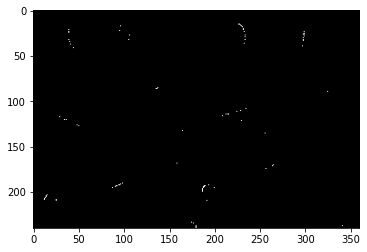

In [ ]:
idx = np.random.randint(superframes.shape[0])
plt.imshow(superframes[idx], cmap = cm.Greys_r)
plt.show()

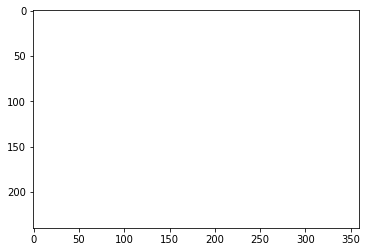

In [ ]:
frames = [] # for storing the generated images
fig = plt.figure()
for i in range(500):
    frames.append([plt.imshow(superframes[i], cmap = cm.Greys_r, animated = True)])

ani = animation.ArtistAnimation(fig, frames, interval = 50, blit = False, repeat_delay = 1000)
HTML(ani.to_jshtml())

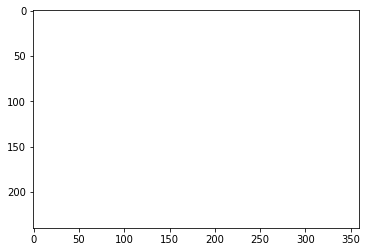

In [ ]:
frames = [] # for storing the generated images
fig = plt.figure()
for i in range(1000):
    frames.append([plt.imshow(superframes[i], cmap = cm.Greys_r, animated = True)])

ani = animation.ArtistAnimation(fig, frames, interval = 50, blit = False, repeat_delay = 1000)
ani.save('video.mp4')
HTML(ani.to_jshtml())

In [ ]:
timestamp = np.array(file['timestamp'].values)
x = np.array(file['x'].values)
y = np.array(file['y'].values)
polarity = np.array(file['polarity'].values)



#Testing graph spectral clustering segmentation values

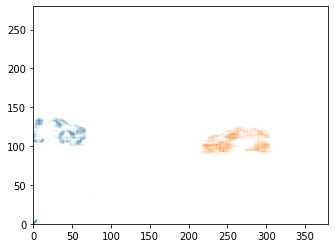

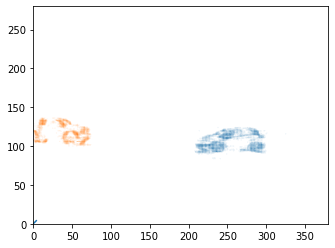

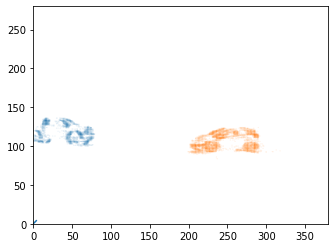

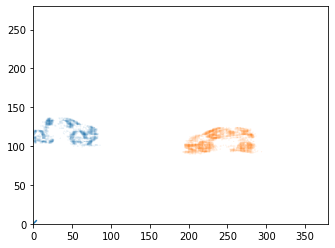

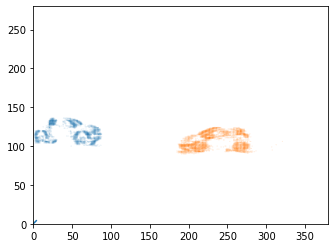

...

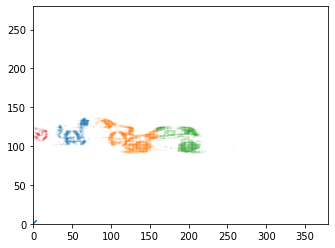

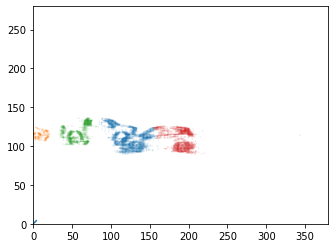

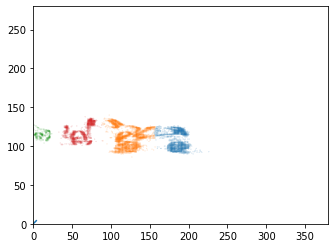

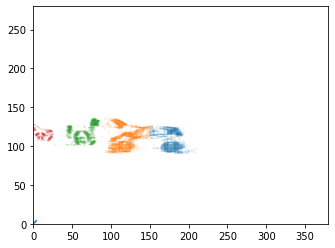

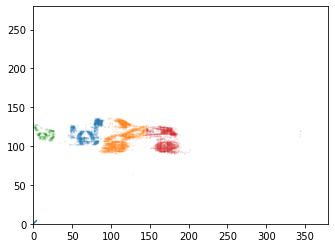

In [ ]:
#testing graph spectral clustering
j=1000
for i in range(1,20):
  yy = str(i)
  file_name = yy
  selected_events = np.load("results/davis240/cars/selected_events/"+file_name+".npy")
  cluster = np.load("results/davis240/cars/clusters/"+file_name+".npy")
  #set plot axis values
  fig,ax = plt.subplots()

  ax.plot(range(5))
  plt.xlim(0, 380)
  plt.ylim(0, 280)
  plt.gca().set_aspect('equal', adjustable='box')
  x = np.array(selected_events[:, 0])
  x = 260-x
  y = np.array(selected_events[:, 1])
  y = 346-y
  z = np.array(selected_events[:, 2]*100)

  for i in range(0,9):
   plt.scatter(y[np.where(cluster == i, True, False)], x[np.where(cluster == i, True, False)], z[np.where(cluster == i, True, False)])

  

  plt.show()

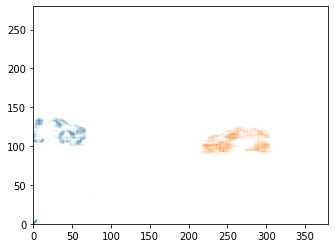

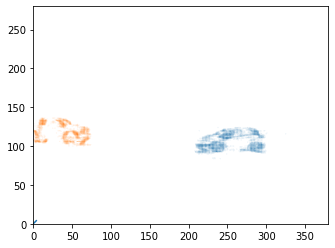

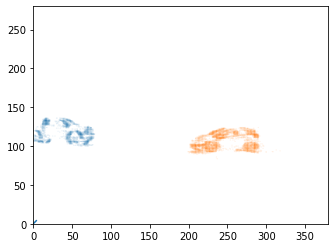

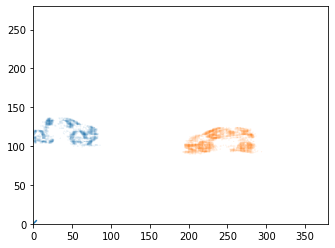

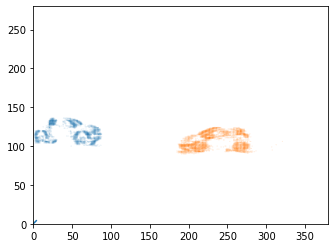

...

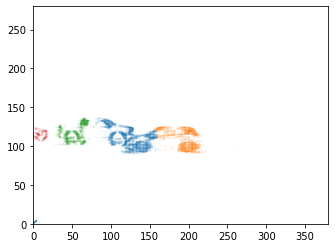

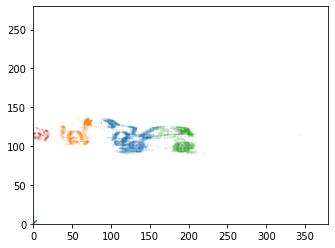

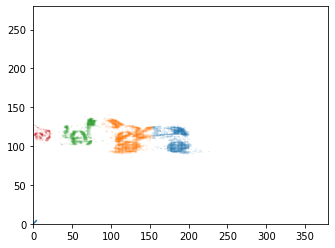

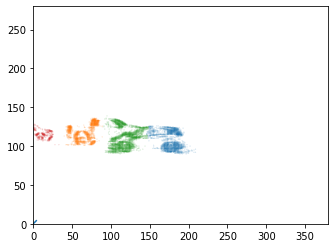

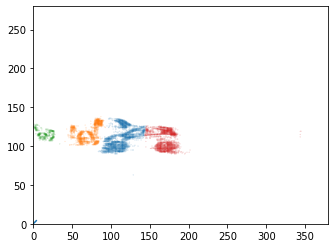

In [ ]:
#testing graph spectral clustering
for i in range(1,20):
  yy = str(i)
  file_name = yy
  selected_events = np.load("results/davis240/cars_656/selected_events/"+file_name+".npy")
  cluster = np.load("results/davis240/cars_656/clusters/"+file_name+".npy")

  #set plot axis values
  fig,ax = plt.subplots()

  ax.plot(range(5))
  plt.xlim(0, 380)
  plt.ylim(0, 280)
  plt.gca().set_aspect('equal', adjustable='box')
  x = np.array(selected_events[:, 0])
  x = 260-x
  y = np.array(selected_events[:, 1])
  y = 346-y
  z = np.array(selected_events[:, 2]*100)

  for i in range(0,9):
   plt.scatter(y[np.where(cluster == i, True, False)], x[np.where(cluster == i, True, False)], z[np.where(cluster == i, True, False)])

  

  plt.show()